# PCA from Scratch

```yaml
Course:   DS 5001
Module:   07 Lab
Topic:    PCA from Scratch
Author:   R.C. Alvarado
Date:     28 Februrary 2023 (revised)
```

**Purpose:**  To implement PCA from scratch and explore application to Austen-Melville corpus.

# Set Up

## Import

In [1]:
import pandas as pd
import numpy as np
from scipy.linalg import norm

In [2]:
import plotly_express as px
import seaborn as sns

In [3]:
sns.set(style='ticks')

## Config

In [4]:
import configparser
config = configparser.ConfigParser()
config.read("../../../env.ini")
data_home = config['DEFAULT']['data_home']
output_dir = config['DEFAULT']['output_dir']
local_lib = config['DEFAULT']['local_lib']

In [5]:
data_prefix = 'austen-melville'

In [6]:
OHCO = ['book_id', 'chap_id']

In [7]:
# Added after class
norm_docs = True # This has the effect of exaggerating variance when False
center_term_vectors = True # This has the effect of demoting authorship when False

We pick a color map for our gradient visualizations. For more info on color maps, see the [Matplotlib docs](https://matplotlib.org/stable/tutorials/colors/colormaps.html) on the subject.

In [8]:
colors = "YlGnBu" 
# colors = "Spectral"

# Prepare the Data

## Import tables

**Downloads**

- [austen-melville-VOCAB2.csv](https://www.dropbox.com/scl/fi/u4t0o5zpoaunyi4l5dklr/austen-melville-VOCAB2.csv?rlkey=5m3fiuucraflg4ntoxqc0t3hv&dl=0)
- [austen-melville-LIB_LABELS.csv](https://www.dropbox.com/scl/fi/f63v0pjqemsody71c9sun/austen-melville-LIB_LABELS.csv?rlkey=0ue1mz9x2ycqybcwti0vsnm9y&dl=0)
- [austen-melville-BOW-CHAPS.csv](https://www.dropbox.com/scl/fi/jykn79w6zfr26bushqoda/austen-melville-BOW-CHAPS.csv?rlkey=c36zwn53lcnsa98crqwb8lozc&dl=0)

In [9]:
LIB = pd.read_csv(f'{output_dir}/{data_prefix}-LIB_LABELS.csv').set_index('book_id')
VOCAB = pd.read_csv(f'{output_dir}/{data_prefix}-VOCAB2.csv').set_index('term_str')
BOW = pd.read_csv(f'{output_dir}/{data_prefix}-BOW-CHAPS.csv').set_index(OHCO+['term_str'])

In [10]:
VOCAB[['n','p','i']].head(20)

,n,p,i
term_str,,,
the,109921,0.053387,4.227375
of,65525,0.031824,4.973725
and,62954,0.030576,5.031473
to,56271,0.027330,5.193379
a,44174,0.021455,5.542573
in,36439,0.017698,5.820287
i,27280,0.013249,6.237927
was,24231,0.011769,6.408917
that,23670,0.011496,6.442711


## Generate reduced `TFIDF` table

We reduce the feature space of the the TFIDF table by selecting the top 1000 significant nouns, verbs, and adjectives.

Note that the `TFIDF` table is an extension of an implied `DOC` table, where each doc is a chapter in this case.

In [11]:
# VOCAB.max_pos_group.value_counts()

In [12]:
TFIDF = BOW['tfidf'].unstack(fill_value=0)
pos_set = ['NN', 'VB']
VSHORT = VOCAB[VOCAB.max_pos_group.isin(['NN', 'VB', 'JJ']) & ~VOCAB.max_pos.isin(['NNP'])].sort_values('dfidf', ascending=False).head(5000)
TFIDF = TFIDF[VSHORT.index]

In [13]:
TFIDF

term_str             sure     hands     short       new      word    passed  \
book_id chap_id                                                               
105     1        0.000000  0.000579  0.000000  0.001180  0.000589  0.000573   
        2        0.000000  0.000770  0.001537  0.000000  0.000783  0.000000   
        3        0.001082  0.000536  0.000535  0.000000  0.000545  0.000000   
        4        0.000000  0.000000  0.002522  0.000000  0.000856  0.000000   
        5        0.001386  0.000458  0.000000  0.000933  0.000930  0.000000   
...                   ...       ...       ...       ...       ...       ...   
34970   110      0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        111      0.000000  0.002806  0.000000  0.000000  0.001426  0.005547   
        112      0.000000  0.004615  0.000000  0.000000  0.000000  0.002281   
        113      0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        114      0.000000  0.002358  0.000000  0.000000  0.000000  0.000000   

term_str             fine      name     given     sight  ...  dreamy  lash  \
book_id chap_id                                          ...                 
105     1        0.000590  0.001161  0.002366  0.000000  ...     0.0   0.0   
        2        0.000000  0.000000  0.000786  0.000000  ...     0.0   0.0   
        3        0.000000  0.003761  0.000547  0.000542  ...     0.0   0.0   
        4        0.000858  0.000844  0.001720  0.000000  ...     0.0   0.0   
        5        0.000466  0.000000  0.000467  0.000000  ...     0.0   0.0   
...                   ...       ...       ...       ...  ...     ...   ...   
34970   110      0.000000  0.000000  0.000000  0.002338  ...     0.0   0.0   
        111      0.000000  0.000000  0.001432  0.000000  ...     0.0   0.0   
        112      0.000000  0.002313  0.000000  0.000000  ...     0.0   0.0   
        113      0.000000  0.000000  0.000000  0.000000  ...     0.0   0.0   
        114      0.000000  0.000000  0.000000  0.002385  ...     0.0   0.0   

term_str         delayed  outrageous  congregation  haul  promoted    offend  \
book_id chap_id                                                                
105     1            0.0         0.0           0.0   0.0  0.002191  0.000000   
        2            0.0         0.0           0.0   0.0  0.000000  0.000000   
        3            0.0         0.0           0.0   0.0  0.000000  0.000000   
        4            0.0         0.0           0.0   0.0  0.000000  0.000000   
        5            0.0         0.0           0.0   0.0  0.000000  0.001712   
...                  ...         ...           ...   ...       ...       ...   
34970   110          0.0         0.0           0.0   0.0  0.000000  0.000000   
        111          0.0         0.0           0.0   0.0  0.000000  0.000000   
        112          0.0         0.0           0.0   0.0  0.000000  0.000000   
        113          0.0         0.0           0.0   0.0  0.000000  0.000000   
        114          0.0         0.0           0.0   0.0  0.000000  0.000000   

term_str         irons  uncertainty  
book_id chap_id                      
105     1          0.0          0.0  
        2          0.0          0.0  
        3          0.0          0.0  
        4          0.0          0.0  
        5          0.0          0.0  
...                ...          ...  
34970   110        0.0          0.0  
        111        0.0          0.0  
        112        0.0          0.0  
        113        0.0          0.0  
        114        0.0          0.0  

[1185 rows x 5000 columns]

## Add some labels to `LIB`

In [14]:
genre_csv = """
105, domestic, romance
121, gothic, satire
141, domestic, satire
158, domestic, romance
161, domestic, romance
946, domestic, romance
1212, domestic, satire
1342, domestic, romance
1900, travel, adventure
2701, sea, adventure
4045, travel, adventure
8118, sea, adventure
10712, sea, critical
13720, sea, adventure
13721, sea, adventure
15422, historical, adventure
15859, mixed, mixed
21816, travel, satire
34970, gothic, psychological
53861, mixed, mixed
""".split('\n')[1:-1]
genre = pd.DataFrame([line.split(', ') for line in genre_csv], columns=['book_id','genre', 'mode'])
genre.book_id = genre.book_id.astype('int')
genre = genre.set_index('book_id')

In [15]:
LIB = pd.concat([LIB, genre], axis=1)

In [16]:
LIB_COLS = ['author','title', 'label', 'genre', 'mode']

In [17]:
LIB[LIB_COLS].head()

,author,title,label,genre,mode
book_id,,,,,
105,"AUSTEN, JANE",PERSUASION,Austen: Persuasion (105),domestic,romance
121,"AUSTEN, JANE",NORTHANGER ABBEY,Austen: Northanger Abbey (121),gothic,satire
141,"AUSTEN, JANE",MANSFIELD PARK,Austen: Mansfield Park (141),domestic,satire
158,"AUSTEN, JANE",EMMA,Austen: Emma (158),domestic,romance
161,"AUSTEN, JANE",SENSE AND SENSIBILITY,Austen: Sense And Sensibilit (161),domestic,romance


# PCA Process

## Normalize doc vector lengths

We use L2 normalization, which scales documents by their pythagorean (Euclidean) length.

In [18]:
# TFIDF_L2 = (TFIDF.T / np.sqrt(np.square(TFIDF).sum(axis=1))).T
TFIDF_L2 = (TFIDF.T / norm(TFIDF, 2, axis=1)).T

In [19]:
TFIDF_L2

term_str             sure     hands     short       new      word    passed  \
book_id chap_id                                                               
105     1        0.000000  0.012707  0.000000  0.025885  0.012913  0.012562   
        2        0.000000  0.016026  0.031978  0.000000  0.016286  0.000000   
        3        0.026946  0.013350  0.013319  0.000000  0.013566  0.000000   
        4        0.000000  0.000000  0.049037  0.000000  0.016649  0.000000   
        5        0.038733  0.012793  0.000000  0.026061  0.026001  0.000000   
...                   ...       ...       ...       ...       ...       ...   
34970   110      0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        111      0.000000  0.039320  0.000000  0.000000  0.019979  0.077741   
        112      0.000000  0.057639  0.000000  0.000000  0.000000  0.028491   
        113      0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
        114      0.000000  0.025922  0.000000  0.000000  0.000000  0.000000   

term_str             fine      name     given     sight  ...  dreamy  lash  \
book_id chap_id                                          ...                 
105     1        0.012943  0.025472  0.051890  0.000000  ...     0.0   0.0   
        2        0.000000  0.000000  0.016361  0.000000  ...     0.0   0.0   
        3        0.000000  0.093661  0.013629  0.013504  ...     0.0   0.0   
        4        0.016687  0.016421  0.033452  0.000000  ...     0.0   0.0   
        5        0.013030  0.000000  0.013060  0.000000  ...     0.0   0.0   
...                   ...       ...       ...       ...  ...     ...   ...   
34970   110      0.000000  0.000000  0.000000  0.024971  ...     0.0   0.0   
        111      0.000000  0.000000  0.020071  0.000000  ...     0.0   0.0   
        112      0.000000  0.028886  0.000000  0.000000  ...     0.0   0.0   
        113      0.000000  0.000000  0.000000  0.000000  ...     0.0   0.0   
        114      0.000000  0.000000  0.000000  0.026222  ...     0.0   0.0   

term_str         delayed  outrageous  congregation  haul  promoted    offend  \
book_id chap_id                                                                
105     1            0.0         0.0           0.0   0.0  0.048058  0.000000   
        2            0.0         0.0           0.0   0.0  0.000000  0.000000   
        3            0.0         0.0           0.0   0.0  0.000000  0.000000   
        4            0.0         0.0           0.0   0.0  0.000000  0.000000   
        5            0.0         0.0           0.0   0.0  0.000000  0.047844   
...                  ...         ...           ...   ...       ...       ...   
34970   110          0.0         0.0           0.0   0.0  0.000000  0.000000   
        111          0.0         0.0           0.0   0.0  0.000000  0.000000   
        112          0.0         0.0           0.0   0.0  0.000000  0.000000   
        113          0.0         0.0           0.0   0.0  0.000000  0.000000   
        114          0.0         0.0           0.0   0.0  0.000000  0.000000   

term_str         irons  uncertainty  
book_id chap_id                      
105     1          0.0          0.0  
        2          0.0          0.0  
        3          0.0          0.0  
        4          0.0          0.0  
        5          0.0          0.0  
...                ...          ...  
34970   110        0.0          0.0  
        111        0.0          0.0  
        112        0.0          0.0  
        113        0.0          0.0  
        114        0.0          0.0  

[1185 rows x 5000 columns]

## Handle NULLs

Remove bags with null. These result from the bags not having terms in the reduced vocabulary.

In [20]:
a = len(TFIDF_L2)
TFIDF_L2 = TFIDF_L2.dropna()
b = len(TFIDF_L2)
bag_loss = a - b
bag_loss

3

## Normalize term vector variance

We do **not** normalize variance, which we would do with data containing divergent units of measure. \
This is because to do so would exaggerate the importance of rare words (see Ng, 2008: 6m40s–8m00s).

## Center the term vectors

We can take the column-wise means (the means for the _term_ vectors), but note that this alters the cosine angles between terms.

We don't don't have to compute this here if we use Pandas method `df.cov(),` which does it for us.

In [21]:
TFIDF_L2 = TFIDF_L2 - TFIDF_L2.mean()

## Compute Covariance Matrix

$n = |X| = |Y|$

$Cov(X,Y) = \dfrac{\sum_{i=1}^{n} (x_i - \mu_X) (y_i - \mu_Y)}{n - 1} = \dfrac{XY}{n-1}$

We could we use the built in Pandas method here, but compute it ourselves.

In [22]:
COV = TFIDF_L2.cov() # This also centers the vectorsf
# COV = TFIDF_L2.T.dot(TFIDF_L2) / (TFIDF_L2.shape[0] - 1) # By Hand

In [23]:
COV.head()

term_str,sure,hands,short,new,word,passed,fine,name,given,sight,...,dreamy,lash,delayed,outrageous,congregation,haul,promoted,offend,irons,uncertainty
term_str,,,,,,,,,,,,,,,,,,,,,
sure,0.000549,-0.000033,0.000066,0.000013,0.000063,0.000043,0.000028,0.000044,5.395837e-05,-8.473096e-06,...,-0.000014,-0.000016,7.161232e-06,-3.761961e-06,-0.000007,-0.000010,8.164664e-07,0.000015,-1.152350e-05,1.265932e-05
hands,-0.000033,0.000266,-0.000008,-0.000004,0.000003,0.000007,0.000007,0.000008,4.602181e-06,1.967502e-05,...,0.000004,0.000004,-3.509814e-06,1.660568e-06,-0.000001,0.000018,1.664547e-06,-0.000002,9.958796e-06,-9.265398e-07
short,0.000066,-0.000008,0.000162,-0.000002,0.000027,0.000027,0.000013,0.000011,3.961367e-05,-1.732312e-06,...,-0.000007,-0.000009,5.757130e-06,-1.649817e-07,0.000006,-0.000002,-7.728678e-08,0.000004,-1.658538e-07,4.719657e-06
new,0.000013,-0.000004,-0.000002,0.000333,0.000003,0.000014,0.000038,0.000016,-8.992483e-07,1.682709e-05,...,0.000003,0.000005,6.304863e-07,-3.374465e-06,0.000004,-0.000005,-4.740632e-06,0.000002,7.608472e-06,-3.651603e-06
word,0.000063,0.000003,0.000027,0.000003,0.000228,0.000015,0.000014,0.000041,2.798171e-05,-4.260087e-07,...,-0.000002,0.000003,1.155233e-05,3.958514e-06,0.000009,-0.000004,-1.740864e-06,0.000005,-8.390774e-07,-3.875961e-07


## Decompose the Matrix

There a at least three options to choose from. We go with SciPy's Hermitian Eigendecomposition \
method `eigh()`, since our covarience matrix is symmetric.

In [24]:
from scipy.linalg import eigh

In [25]:
eig_vals, eig_vecs = eigh(COV)

## Convert eigen data to dataframes

In [26]:
EIG_VEC = pd.DataFrame(eig_vecs, index=COV.index, columns=COV.index)
EIG_VAL = pd.DataFrame(eig_vals, index=COV.index, columns=['eig_val'])
EIG_VAL.index.name = 'term_str'

In [27]:
EIG_VEC.iloc[:10, :10].style.background_gradient(cmap=colors)

term_str,sure,hands,short,new,word,passed,fine,name,given,sight
term_str,,,,,,,,,,
sure,-0.013206,-0.001049,-0.049685,-0.171814,-0.097588,0.049592,-0.062557,0.167611,0.183097,0.203515
hands,-0.565889,-0.041834,0.019931,0.025266,0.012115,-0.012698,0.001632,-0.030532,0.008175,-0.020140
short,0.240210,0.023878,-0.037018,-0.057265,-0.062746,-0.030317,-0.043781,0.075922,0.135631,0.087766
new,-0.029786,-0.017468,-0.010884,0.017967,0.032150,0.108861,-0.025391,0.120387,0.046125,0.135929
word,-0.033840,0.014469,-0.010215,0.031932,-0.002819,-0.005761,0.001322,0.003118,0.029516,-0.007744
passed,0.033747,0.024174,0.008819,0.611275,0.028902,0.012963,-0.034591,-0.014708,0.096729,0.063364
fine,-0.066295,-0.003267,0.010364,0.154366,0.015882,-0.014504,0.002843,-0.014237,0.030239,-0.016770
name,0.004378,0.009135,-0.007930,0.063622,-0.006694,0.026512,0.004485,0.005666,0.006448,0.008966
given,-0.170901,-0.050981,-0.004589,-0.036255,0.066200,0.025591,0.035625,0.006731,0.001345,0.019302


## Explore Term Pairs

In [28]:
EIG_VEC_PAIRS = EIG_VEC.stack().sort_values(ascending=False).to_frame('covariance')
EIG_VEC_PAIRS.index.names = ['term1', 'term2']

In [29]:
EIG_VEC_PAIRS.head(20)

,,covariance
term1,term2,
passed,new,0.611275
natives,hands,0.508461
acquaintance,coward,0.495849
worth,short,0.468042
ye,leather,0.427855
family,anchors,0.414570
cocoa,popular,0.383557
whale,promoted,0.367830
fish,youre,0.338306


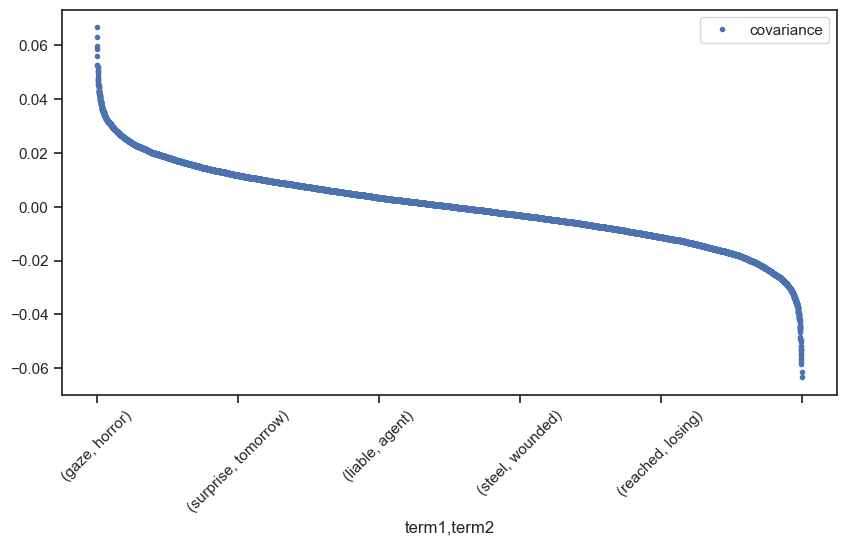

In [30]:
EIG_VEC_PAIRS.sample(10000).sort_values('covariance', ascending=False).plot(rot=45, style='.', figsize=(10,5));

## Select Principal Components

Next, we associate each eigenvalue with its corresponding *column* in the eigenvalue matrix. \
This is why we transpose the `EIG_VEC` dataframe.

## Combine eigenvalues and eignvectors

In [31]:
EIG_PAIRS = EIG_VAL.join(EIG_VEC.T)

In [32]:
EIG_PAIRS.sort_values('eig_val', ascending=False).head(10)

,eig_val,sure,hands,short,new,word,passed,fine,name,given,...,dreamy,lash,delayed,outrageous,congregation,haul,promoted,offend,irons,uncertainty
term_str,,,,,,,,,,,,,,,,,,,,,
uncertainty,0.029673,0.078832,-0.016557,0.025820,0.001684,0.021083,0.019901,0.006658,0.011127,0.030794,...,-0.004945,-0.005851,0.008719,-0.002698,-0.002933,-0.008019,0.000276,0.006220,-0.006192,0.004458
irons,0.012925,0.006546,0.016911,0.019903,0.009487,0.005835,0.005396,0.018617,0.010174,0.011343,...,0.001255,0.005806,-0.000318,0.001666,0.005751,0.010960,0.003792,0.001850,0.008984,-0.002259
offend,0.010339,-0.030248,-0.015663,-0.008832,-0.001216,-0.019575,-0.002024,0.001263,-0.008497,-0.007879,...,0.004670,0.002362,-0.002685,0.002389,0.005273,-0.012668,0.004290,-0.001273,-0.016157,-0.000861
promoted,0.009170,-0.017788,-0.038094,-0.012158,-0.013281,-0.024301,-0.019972,-0.021830,-0.022850,-0.009579,...,0.001712,-0.009116,-0.002229,-0.003317,-0.002916,-0.013159,-0.002620,-0.001873,-0.004156,-0.002402
haul,0.007832,0.001458,0.008497,0.020778,0.016711,0.014691,0.029975,0.015016,0.013145,-0.000312,...,0.006849,-0.019597,0.002958,0.001604,0.008932,-0.004914,0.000350,0.001642,0.002269,0.003124
congregation,0.006182,-0.039125,-0.004665,-0.000656,-0.026721,-0.021379,-0.001405,-0.027117,0.002634,0.016987,...,-0.001688,0.010357,0.002128,0.001901,-0.000280,0.007849,-0.000604,-0.001564,0.004005,0.004312
outrageous,0.005501,-0.003132,0.013102,-0.004873,0.014875,-0.006897,0.008189,0.010238,0.013079,0.014308,...,-0.000041,0.031087,0.001653,0.004166,-0.007767,0.004324,0.009422,0.003661,0.001623,0.003235
delayed,0.005266,-0.019920,0.001511,0.006262,0.022864,0.018687,-0.015263,0.042048,0.024614,-0.000659,...,-0.008432,0.015152,-0.006097,0.008295,0.023010,-0.015807,0.005798,0.002215,0.001609,-0.000774
lash,0.004493,-0.038168,0.003029,-0.008728,0.044229,-0.003378,0.030302,0.006354,0.000464,-0.001691,...,0.015614,-0.013533,0.003572,-0.000572,-0.004115,-0.001812,-0.002194,-0.002795,-0.008312,0.004818


Next, we sort in descending order and pick the top K (=10).

## Compute and Show Explained Variance

We might use this value to sort our components.

In [33]:
EIG_PAIRS['exp_var'] = np.round((EIG_PAIRS.eig_val / EIG_PAIRS.eig_val.sum()) * 100, 2)

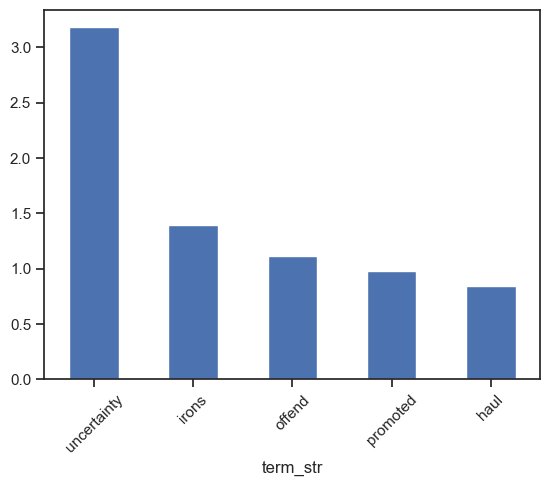

In [34]:
EIG_PAIRS.exp_var.sort_values(ascending=False).head().plot.bar(rot=45);

## Pick Top K (10) Components

We pick these based on explained variance.

In [35]:
COMPS = EIG_PAIRS.sort_values('exp_var', ascending=False).head(10).reset_index(drop=True)
COMPS.index.name = 'comp_id'
COMPS.index = ["PC{}".format(i) for i in COMPS.index.tolist()]
COMPS.index.name = 'pc_id'

In [36]:
COMPS

,eig_val,sure,hands,short,new,word,passed,fine,name,given,...,lash,delayed,outrageous,congregation,haul,promoted,offend,irons,uncertainty,exp_var
pc_id,,,,,,,,,,,,,,,,,,,,,
PC0,0.029673,0.078832,-0.016557,0.025820,0.001684,0.021083,0.019901,0.006658,0.011127,0.030794,...,-0.005851,0.008719,-0.002698,-0.002933,-0.008019,0.000276,0.006220,-0.006192,0.004458,3.18
PC1,0.012925,0.006546,0.016911,0.019903,0.009487,0.005835,0.005396,0.018617,0.010174,0.011343,...,0.005806,-0.000318,0.001666,0.005751,0.010960,0.003792,0.001850,0.008984,-0.002259,1.39
PC2,0.010339,-0.030248,-0.015663,-0.008832,-0.001216,-0.019575,-0.002024,0.001263,-0.008497,-0.007879,...,0.002362,-0.002685,0.002389,0.005273,-0.012668,0.004290,-0.001273,-0.016157,-0.000861,1.11
PC3,0.009170,-0.017788,-0.038094,-0.012158,-0.013281,-0.024301,-0.019972,-0.021830,-0.022850,-0.009579,...,-0.009116,-0.002229,-0.003317,-0.002916,-0.013159,-0.002620,-0.001873,-0.004156,-0.002402,0.98
PC4,0.007832,0.001458,0.008497,0.020778,0.016711,0.014691,0.029975,0.015016,0.013145,-0.000312,...,-0.019597,0.002958,0.001604,0.008932,-0.004914,0.000350,0.001642,0.002269,0.003124,0.84
PC5,0.006182,-0.039125,-0.004665,-0.000656,-0.026721,-0.021379,-0.001405,-0.027117,0.002634,0.016987,...,0.010357,0.002128,0.001901,-0.000280,0.007849,-0.000604,-0.001564,0.004005,0.004312,0.66
PC6,0.005501,-0.003132,0.013102,-0.004873,0.014875,-0.006897,0.008189,0.010238,0.013079,0.014308,...,0.031087,0.001653,0.004166,-0.007767,0.004324,0.009422,0.003661,0.001623,0.003235,0.59
PC7,0.005266,-0.019920,0.001511,0.006262,0.022864,0.018687,-0.015263,0.042048,0.024614,-0.000659,...,0.015152,-0.006097,0.008295,0.023010,-0.015807,0.005798,0.002215,0.001609,-0.000774,0.56
PC8,0.004493,-0.038168,0.003029,-0.008728,0.044229,-0.003378,0.030302,0.006354,0.000464,-0.001691,...,-0.013533,0.003572,-0.000572,-0.004115,-0.001812,-0.002194,-0.002795,-0.008312,0.004818,0.48


## See Projected Components onto Vocabulary (Loadings)

Loadings sow the contribution of each term to the component. \
We'll just look at the topi 10 words for the first two components in the Book version.

In [37]:
LOADINGS = COMPS[COV.index].T
LOADINGS.index.name = 'term_str'

In [38]:
LOADINGS.head(10).style.background_gradient(cmap=colors)

pc_id,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9
term_str,,,,,,,,,,
sure,0.078832,0.006546,-0.030248,-0.017788,0.001458,-0.039125,-0.003132,-0.019920,-0.038168,0.037160
hands,-0.016557,0.016911,-0.015663,-0.038094,0.008497,-0.004665,0.013102,0.001511,0.003029,-0.002705
short,0.025820,0.019903,-0.008832,-0.012158,0.020778,-0.000656,-0.004873,0.006262,-0.008728,-0.017145
new,0.001684,0.009487,-0.001216,-0.013281,0.016711,-0.026721,0.014875,0.022864,0.044229,0.016614
word,0.021083,0.005835,-0.019575,-0.024301,0.014691,-0.021379,-0.006897,0.018687,-0.003378,-0.002748
passed,0.019901,0.005396,-0.002024,-0.019972,0.029975,-0.001405,0.008189,-0.015263,0.030302,0.008524
fine,0.006658,0.018617,0.001263,-0.021830,0.015016,-0.027117,0.010238,0.042048,0.006354,0.047148
name,0.011127,0.010174,-0.008497,-0.022850,0.013145,0.002634,0.013079,0.024614,0.000464,-0.007387
given,0.030794,0.011343,-0.007879,-0.009579,-0.000312,0.016987,0.014308,-0.000659,-0.001691,-0.009277


In [39]:
top_terms = []
for i in range(10):
    for j in [0, 1]:
        comp_str = ' '.join(LOADINGS.sort_values(f'PC{i}', ascending=bool(j)).head(10).index.to_list())
        top_terms.append((f"PC{i}", j, comp_str))
COMP_GLOSS = pd.DataFrame(top_terms).set_index([0,1]).unstack()
COMP_GLOSS.index.name = 'comp_id'
COMP_GLOSS.columns = COMP_GLOSS.columns.droplevel(0) 
COMP_GLOSS = COMP_GLOSS.rename(columns={0:'pos', 1:'neg'})

In [40]:
COMP_GLOSS

1,pos,neg
comp_id,,
PC0,am sister dear think letter had mother do wish...,whale thou sea ship ye deck thee boat thy whales
PC1,whale ship deck sailors boat mate sea ships wa...,thou thee thy hath art oh hast brother ye thine
PC2,valley natives doctor island islanders canoe l...,whale whales thou thee boat ye boats ship thy ...
PC3,whale whales fish valley oil acquaintance tail...,thou thee deck thy ship sailors mate jacket ye...
PC4,valley natives islanders island thou fruit tre...,war deck jacket officers gun top sailors friga...
PC5,thee thou natives thy mother valley daughter o...,lord said ye dont cried wine ha beard yes old
PC6,lord war officers beard frigate american kings...,doctor dont ye cabin confidence consul door ge...
PC7,whale book war american confidence doctor port...,boat sea sail canoe ye reef breeze sails land ...
PC8,portrait mother book soul bed seemed room fath...,doctor thou natives lord ye thee island consul...


In [41]:
# COMPS.join(COMP_GLOSS)

## Project Docs onto Components

We get the dot product of the DTM matrix and the new component matrix, which we will call DCM -- for document-component matrix. \
This has the effect of replacing the features of the DTM with the features of the transposed component matrix.

In [42]:
# We use the index to get only PC features, so matrices align
DCM = TFIDF_L2.dot(COMPS[COV.index].T) 

We add metadata to our new, reduced matrices for display purposes.

In [43]:
DCM = DCM.join(LIB[LIB_COLS], on='book_id')

We define a `doc` field to name each chapter.

In [44]:
DCM['doc'] = DCM.apply(lambda x: f"{x.label} {str(x.name[1]).zfill(2)}", 1)

In [45]:
DCM.doc

book_id  chap_id
105      1                         Austen: Persuasion (105) 01
         2                         Austen: Persuasion (105) 02
         3                         Austen: Persuasion (105) 03
         4                         Austen: Persuasion (105) 04
         5                         Austen: Persuasion (105) 05
                                       ...                    
34970    110        Melville: Pierre Or The Ambigu (34970) 110
         111        Melville: Pierre Or The Ambigu (34970) 111
         112        Melville: Pierre Or The Ambigu (34970) 112
         113        Melville: Pierre Or The Ambigu (34970) 113
         114        Melville: Pierre Or The Ambigu (34970) 114
Name: doc, Length: 1182, dtype: object

In [46]:
DCM

PC0       PC1       PC2       PC3       PC4       PC5  \
book_id chap_id                                                               
105     1        0.231974  0.007762  0.017989  0.065966 -0.016486  0.095094   
        2        0.215447  0.016352  0.012553  0.053151  0.000034  0.088029   
        3        0.205868  0.055338 -0.012631 -0.054045 -0.004857 -0.028804   
        4        0.225049  0.006186  0.008485  0.055687 -0.011561  0.112697   
        5        0.321501  0.050334 -0.032308 -0.045448  0.071844 -0.023743   
...                   ...       ...       ...       ...       ...       ...   
34970   110     -0.154963 -0.212695 -0.062256 -0.098602  0.058096  0.078026   
        111     -0.078093 -0.225729 -0.048201 -0.083009  0.004166  0.024352   
        112     -0.100179 -0.057010  0.035908 -0.012414  0.009604 -0.017429   
        113     -0.130200 -0.310046 -0.048509 -0.073031 -0.020033  0.044484   
        114     -0.138842 -0.216313 -0.044206 -0.143686  0.021920  0.017594   

                      PC6       PC7       PC8       PC9            author  \
book_id chap_id                                                             
105     1        0.085920  0.047278  0.075099  0.001546      AUSTEN, JANE   
        2        0.043210  0.025328  0.002466 -0.069693      AUSTEN, JANE   
        3        0.073532  0.081581 -0.045062  0.036613      AUSTEN, JANE   
        4        0.081198  0.009942  0.037818 -0.140859      AUSTEN, JANE   
        5        0.004670  0.031981  0.001046  0.104847      AUSTEN, JANE   
...                   ...       ...       ...       ...               ...   
34970   110     -0.044103 -0.065702  0.011673 -0.011808  MELVILLE, HERMAN   
        111     -0.061809  0.071034  0.071081 -0.008517  MELVILLE, HERMAN   
        112     -0.052970  0.001782  0.070923  0.052285  MELVILLE, HERMAN   
        113     -0.020777  0.024894  0.030559  0.023847  MELVILLE, HERMAN   
        114     -0.052071  0.018955  0.015387  0.031179  MELVILLE, HERMAN   

                                     title  \
book_id chap_id                              
105     1                       PERSUASION   
        2                       PERSUASION   
        3                       PERSUASION   
        4                       PERSUASION   
        5                       PERSUASION   
...                                    ...   
34970   110      PIERRE OR THE AMBIGUITIES   
        111      PIERRE OR THE AMBIGUITIES   
        112      PIERRE OR THE AMBIGUITIES   
        113      PIERRE OR THE AMBIGUITIES   
        114      PIERRE OR THE AMBIGUITIES   

                                                  label     genre  \
book_id chap_id                                                     
105     1                      Austen: Persuasion (105)  domestic   
        2                      Austen: Persuasion (105)  domestic   
        3                      Austen: Persuasion (105)  domestic   
        4                      Austen: Persuasion (105)  domestic   
        5                      Austen: Persuasion (105)  domestic   
...                                                 ...       ...   
34970   110      Melville: Pierre Or The Ambigu (34970)    gothic   
        111      Melville: Pierre Or The Ambigu (34970)    gothic   
        112      Melville: Pierre Or The Ambigu (34970)    gothic   
        113      Melville: Pierre Or The Ambigu (34970)    gothic   
        114      Melville: Pierre Or The Ambigu (34970)    gothic   

                          mode                                         doc  
book_id chap_id                                                             
105     1              romance                 Austen: Persuasion (105) 01  
        2              romance                 Austen: Persuasion (105) 02  
        3              romance                 Austen: Persuasion (105) 03  
        4              romance                 Austen: Persuasion (105) 04  
        5              romance   

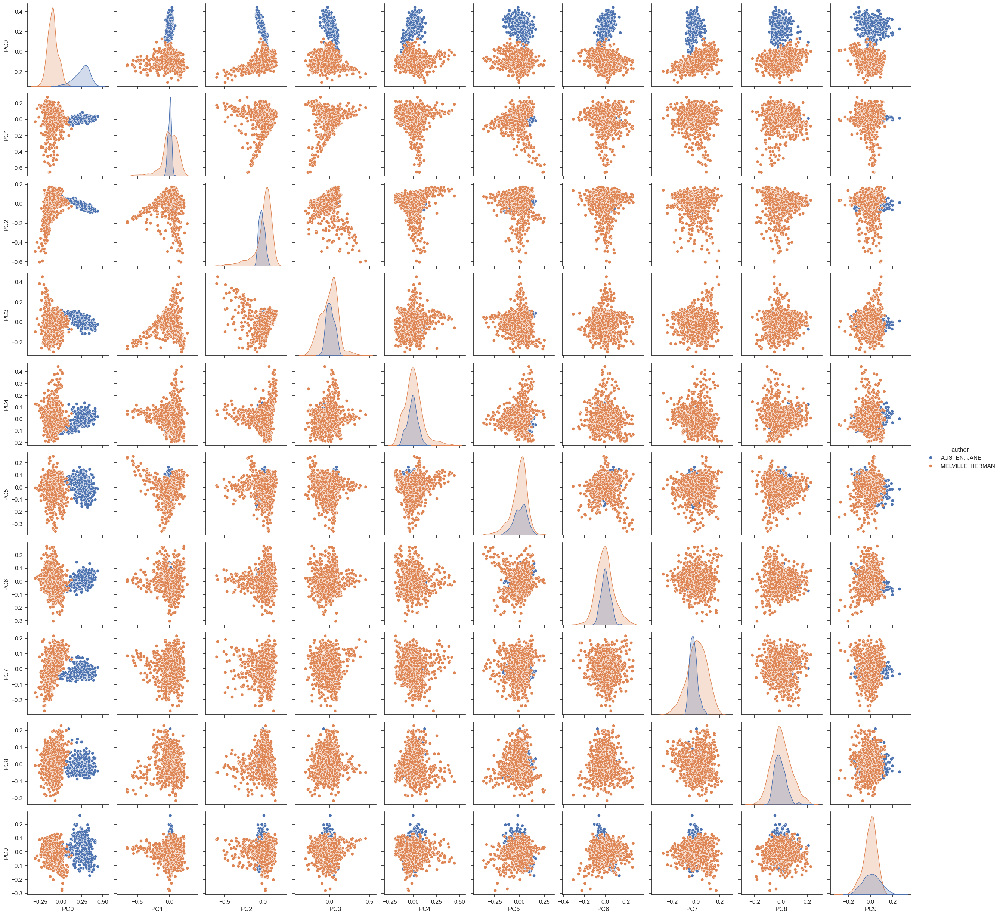

In [47]:
sns.pairplot(DCM.iloc[:, :], hue='author')

# Visualize

In [48]:
def vis_pcs(M, a, b, label='author', hover_name='doc', symbol=None, size=None):
    return px.scatter(M, f"PC{a}", f"PC{b}", color=label, hover_name=hover_name, 
                     symbol=symbol, size=size,
                     marginal_x='box', height=800)

In [49]:
def vis_loadings(a=0, b=1, hover_name='term_str'):
    # X = LOADINGS.join(VOCAB)
    X = LOADINGS.join(VSHORT)
    return px.scatter(X.reset_index(), f"PC{a}", f"PC{b}", 
                      text='term_str', size='i', color='max_pos_group', 
                      marginal_x='box', height=800)

## PC 0 and 1

### Author

In [50]:
vis_pcs(DCM, 0, 1)

### Loadings

In [51]:
vis_loadings(0,1)

In [52]:
vis_pcs(DCM, 0, 1, label='label')

### Genre

In [53]:
vis_pcs(DCM, 0, 1, label='genre')

### Mode

In [54]:
vis_pcs(DCM, 0, 1, label='mode')

### Title

In [55]:
vis_pcs(DCM, 0, 1, label='label')

## PC 1 and 2

### Author

In [56]:
vis_pcs(DCM, 1, 2)

### Loadings

In [57]:
vis_loadings(1, 2)

### Genre

In [58]:
vis_pcs(DCM, 1, 2, label='genre')

### Mode

In [59]:
vis_pcs(DCM, 1, 2, label='mode')

### Title

In [60]:
vis_pcs(DCM, 1, 2, label='label')

## PC 2 and 3

### Author

In [61]:
vis_pcs(DCM, 2, 3)

### Loadings

In [62]:
vis_loadings(2, 3)

### Genre

In [63]:
vis_pcs(DCM, 2, 3, label='genre')

### Mode

In [64]:
vis_pcs(DCM, 2, 3, label='mode', symbol='author')

### Title

In [65]:
vis_pcs(DCM, 2, 3, label='label')

## PC 3 and 4

### Author

In [66]:
vis_pcs(DCM, 3, 4, label='author')

### Loadings

In [67]:
vis_loadings(3, 4)

### Genre

In [68]:
vis_pcs(DCM, 3, 4, label='genre')

### Mode

In [69]:
vis_pcs(DCM, 3, 4, label='mode')

### Title

In [70]:
vis_pcs(DCM, 3, 4, label='label')

## Dendrograms

In [71]:
import sys
sys.path.append(local_lib)
from hac import HAC

In [72]:
X = DCM[COMPS.index].groupby('book_id').mean()
titles = LIB.loc[list(X.index)].apply(lambda x: x.label + ' ' + x.genre.upper(), 1)
X.index = titles

<Axes: >

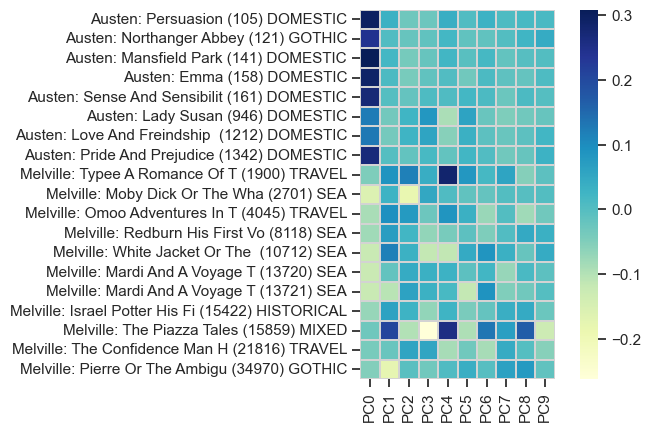

In [73]:
sns.heatmap(X, cmap='YlGnBu', square=True, linewidths=.01, linecolor='lightgray')

<Figure size 640x480 with 0 Axes>

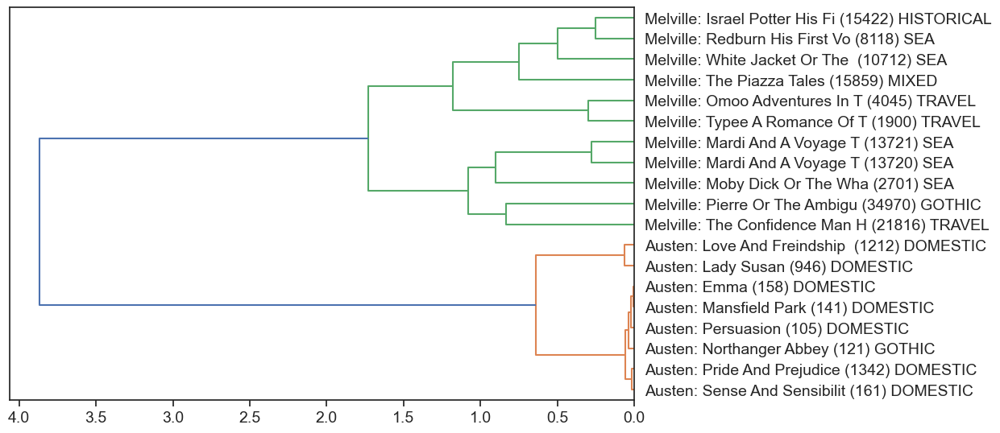

In [74]:
HAC(X).plot();

In [75]:
XV = LOADINGS.loc[VSHORT.sort_values('dfidf', ascending=False).head(100).index]

<Figure size 640x480 with 0 Axes>

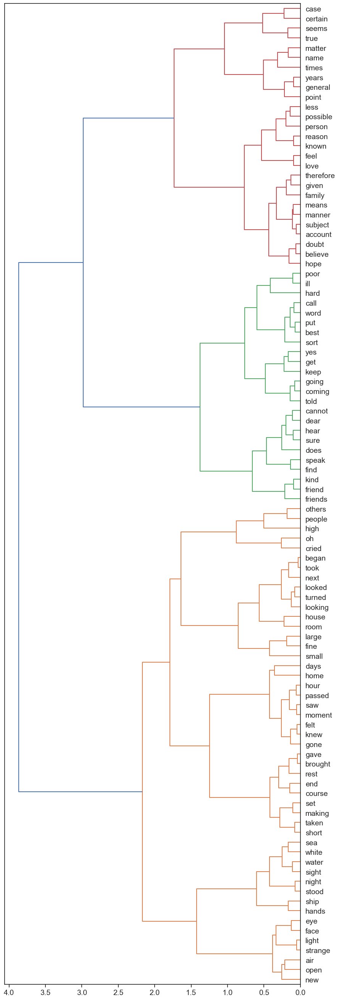

In [76]:
HAC(XV).plot()

In [77]:
XV2 = LOADINGS.loc[VSHORT.sample(50).index]

<Figure size 640x480 with 0 Axes>

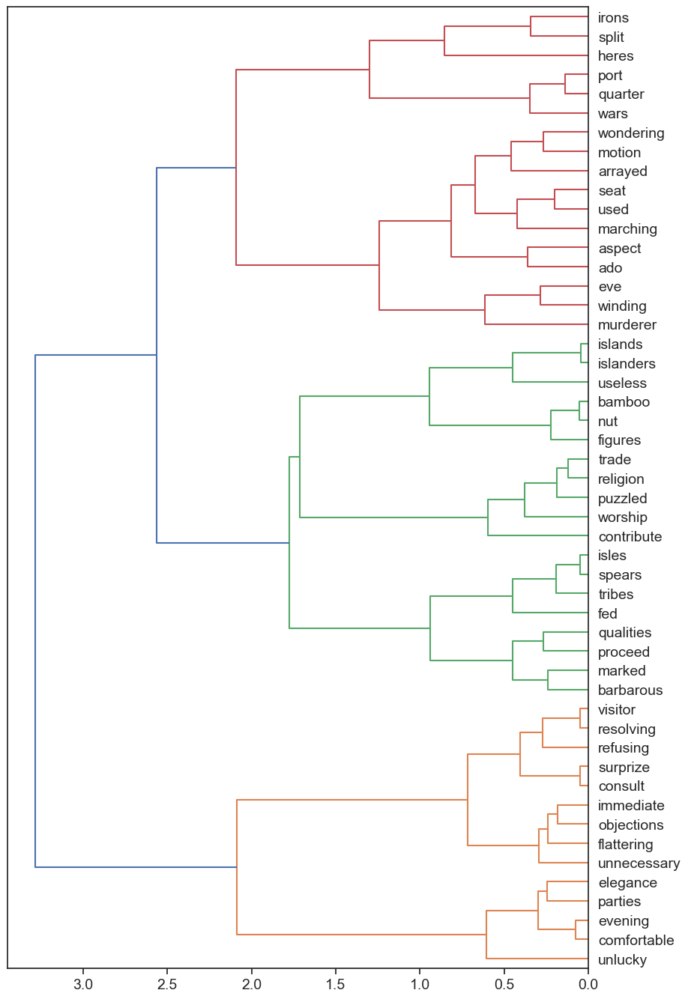

In [78]:
HAC(XV2).plot()

# SAVE

In [79]:
# TFIDF.to_csv(f"{output_dir}/{data_prefix}-TFIDF_chap.csv")
TFIDF_L2.to_csv(f"{output_dir}/{data_prefix}-TFIDF_chap_L2.csv")
DCM.iloc[:,:10].to_csv(f"{output_dir}/{data_prefix}-PCA_DCM_chap.csv")
COMPS.iloc[:,[0,-1]].to_csv(f"{output_dir}/{data_prefix}-PCA_COMPS_chap.csv")
LOADINGS.to_csv(f"{output_dir}/{data_prefix}-PCA_TCM_chap.csv")